In [1]:
import glob

In [2]:
from opsimsummary import healpix_boundaries

In [3]:
import numpy as np
import healpy as hp

In [4]:
%matplotlib inline
import matplotlib.pyplot as plt
from matplotlib.patches import Polygon
from mpl_toolkits.basemap import Basemap

In [5]:
import pandas as pd

In [90]:
import sncosmo

In [6]:
from opsimsummary import OpSimOutput

In [7]:
import opsimsummary as oss

In [8]:
from sqlalchemy import create_engine

In [92]:
from astropy.cosmology import Planck15

In [23]:
from astropy.time import Time, TimeDelta, TimeDeltaJD
import datetime

In [88]:
from copy import deepcopy

In [9]:
import os

In [10]:
from opsimsummary import convertToSphericalCoordinates, healpix_boundaries

In [11]:
import healpy as hp

In [12]:
engine = create_engine('sqlite:////Users/rbiswas/Downloads/test_schedule_v3.db')

In [13]:
df = pd.read_sql_table('Summary', con=engine)
df.obsHistID = df.obsHistID.astype(np.int)
df.set_index('obsHistID', inplace=True)
df.expMJD = df.expMJD + 365 * 2 # ZTF is not done

In [15]:
df.expMJD.describe()

count    174854.000000
mean      58302.598386
std         108.754394
min       58121.146384
25%       58202.340858
50%       58307.261935
75%       58398.260618
max       58482.578109
Name: expMJD, dtype: float64

In [16]:
from astropy import time

In [18]:
import datetime

In [24]:
df.query('filter=="g"').head()

,sessionID,propID,fieldID,fieldRA,fieldDec,filter,expDate,expMJD,night,visitTime,...,rawSeeing,wind,humidity,slewDist,slewTime,fiveSigmaDepth,ditheredRA,ditheredDec,totalRequestsTonight,metricValue
obsHistID,,,,,,,,,,,,,,,,,,,,,
88,0,2,450,0.458529,0.079412,g,277335,58121.209907,3,30.0,...,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,2,0.0
89,0,2,451,0.580892,0.079412,g,277376,58121.210374,3,30.0,...,NaN,NaN,NaN,0.121977,10.373100,0.0,0.0,0.0,2,0.0
90,0,2,504,0.640446,0.205076,g,277416,58121.210837,3,30.0,...,NaN,NaN,NaN,0.138787,10.000000,0.0,0.0,0.0,2,0.0
91,0,2,505,0.762344,0.205076,g,277457,58121.211315,3,30.0,...,NaN,NaN,NaN,0.119341,11.278392,0.0,0.0,0.0,2,0.0
92,0,2,452,0.703255,0.079412,g,277497,58121.211778,3,30.0,...,NaN,NaN,NaN,0.138593,10.000000,0.0,0.0,0.0,2,0.0


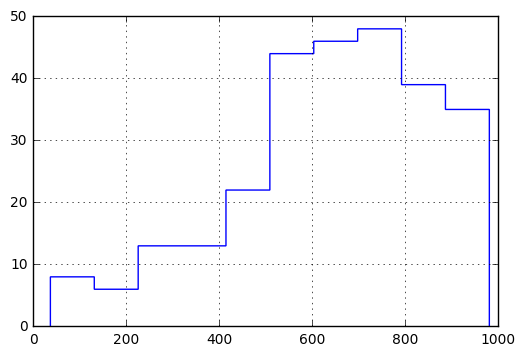

In [25]:
def read_sim(fname='/Users/rbiswas/Downloads/sn_coord_time.dat'):
    df = pd.read_csv(fname,
                     skiprows=1, delim_whitespace=True,
                     names=('z', 'ra', 'dec', 't0'))
    #df.ra = df.ra * 360./24.0 - 180.
    df.t0 = df.t0 - 2400000.5
    return df
df.groupby(['night']).sessionID.count().hist(histtype='step')
simsdf = read_sim()

In [28]:
simsdf.describe()
# Checks 
## ra should go from -180 to + 180
## dec should go from -30 to 90
## z should go from 0 to 0.2

,z,ra,dec,t0
count,24512.000000,24512.000000,24512.000000,24512.000000
mean,0.146721,-0.290713,16.914396,58218.011605
std,0.040164,103.555650,28.720710,57.956797
min,0.006066,-179.996135,-29.988178,58118.505713
25%,0.120396,-88.740055,-7.018825,58167.797523
50%,0.155396,-0.553733,14.373132,58217.713759
75%,0.179848,89.110851,38.634464,58267.920164
max,0.199996,179.996483,89.371606,58318.635003


In [29]:
simsdf.head()

,z,ra,dec,t0
0,0.150856,177.009298,-9.541729,58158.737911
1,0.193961,-142.895644,-16.445698,58171.555313
2,0.185266,104.668543,5.147820,58304.201365
3,0.101136,93.239688,81.126166,58232.383343
4,0.137615,39.767127,0.367004,58192.249369


In [121]:
# Fields
class VisibleFields(object):
    def __init__(self, data_dir, offset=0.):
        self._data_dir = data_dir
        self.visible_fields = glob.glob(data_dir + '/*.da')
        self.dates = np.array(list(np.float(x.split('/')[-1].strip('.da')) for x in self.visible_fields))
        self.dates.sort()
        self.offset = offset
        self.colordict=dict(g='g', r='r', i='y')
    def filenameFromMjd(self, mjd):
        jd = np.int(mjd + 2400000.5 + self.offset)
        fname = '{:d}'.format(jd)
        return os.path.join(self._data_dir, fname + '.da')
    
    def _minutes_since_noon2mjd(self, expMJD, minutes=0, utc_offset=-5):
        # Datetime object corresponding to Noon at UTC
        dt = Time(np.floor(expMJD), format='mjd')
        # Use utc_offset to switch to Palomar local time
        DeltaT = TimeDelta(utc_offset * 3600 + minutes*60, format='sec')
        xx = dt + DeltaT
        return xx.mjd
    
    def fieldCoords(self, mjd):
        fname = self.filenameFromMjd(mjd)
        df = pd.read_csv(fname, delim_whitespace=True, skiprows=1, names=['ind', 'ra', 'dec', 'start', 'end', 'on'],
                         index_col='ind')
        # convert ra to degrees from -180. to 180. from hours
        df.ra = df.ra * 360./24.0 - 180.
        
        # Start and end times
        df.start = list(self._minutes_since_noon2mjd(mjd, v) for v in df.start.values)
        df.end = list(self._minutes_since_noon2mjd(mjd, v) for v in df.end.values)
        
        return df
    def healpixels(self, mjd, nside=8):
        df = self.fieldCoords(mjd).query('on > 0.5 and @mjd < end and @mjd > start')
        theta, phi = convertToSphericalCoordinates(df.ra.values, df.dec.values, unit='degrees')
        phi = phi + np.pi
        ipix = hp.ang2pix(nside=nside, theta=theta, phi=phi, nest=True)
        ipix.sort()
        return np.unique(ipix)
    def pixel_patches(self, mjd, m, nside=8, facecolor='k', alpha=1., ipix=None):
        patches = []
        if ipix is None:
            ipix = self.healpixels(mjd=mjd, nside=nside)
        for pix in ipix:
            lon, lat = healpix_boundaries(pix, nside=nside, units='degrees',
                                          convention='celestial', step=10,
                                          nest=True)
            x, y = m(lon, lat)
            xy = zip(x, y)
            p = Polygon(xy, facecolor=facecolor, fill=True,alpha=alpha, edgecolor='k', lw=0)
            patches.append(p)
        return patches
    def generate_image(self, obsHistID, df, snsims=None):
        
        mjd = df.ix[obsHistID, 'expMJD']
        band = df.ix[obsHistID, 'filter']
        ra = np.degrees(df.ix[obsHistID, 'fieldRA'])
        dec = np.degrees(df.ix[obsHistID, 'fieldDec'])
        # generate fig
        fig, ax = plt.subplots()#1, 2)
        #ax = axx[0]
        m = Basemap(#llcrnrlat=-32., llcrnrlon=48.,
                    #urcrnrlat=-22., urcrnrlon=58,
                    projection='moll', lon_0=0., lat_0=0.,
                    ax=ax, celestial=True)
        _ = m.drawparallels(np.arange(-91.,91.,20.))
        _ = m.drawmeridians(np.arange(-180., 181., 30.))
        # color the sky blue
        _ = m.drawmapboundary(color='b', fill_color='b')
        ####_allpatches = self.pixel_patches(mjd, m=m, nside=32, facecolor='b', alpha=0.8, 
        ####                                 ipix=np.arange(hp.nside2npix(32)))
        ####_ = list(ax.add_patch(p) for p in _allpatches)
        # color visible fields black
        vispatches = self.pixel_patches(mjd=mjd, m=m, nside=8)
        _ = list(ax.add_patch(p) for p in vispatches)
        # put the field of view
        m.tissot(lon_0=ra, lat_0=dec, radius_deg=4., npts=100, ax=ax,
         **dict(fill=False, edgecolor=self.colordict[band], lw=2))
        if snsims is not None:
            scatter_vals = self.sn_scatter(obsHistID, df, snsims)
            x, y = m(scatter_vals.ra.values, scatter_vals.dec.values)
            ax.scatter(x, y, s=scatter_vals.rad.values, c='w', edgecolors='w', zorder=10)
        return fig, ax, m
    def generate_images(self, obsHistIDs, df, snsims=None, savefig=False, outdir='./'):
        figs = list(self.generate_image(obsHistID, df, snsims=snsims)[0] for obsHistID in obsHistIDs)
        mjd = df.ix[obsHistIDs, 'expMJD'].values
        if savefig:
            for obsHistID, fig in zip(obsHistIDs, figs):
                fname = os.path.join(outdir, 'ztf_obsHistID_{:06d}.png'.format(np.int(obsHistID)))
                #print(type(fig), fname)
                fig.savefig(fname)
        return figs, obsHistIDs
    def sn_scatter(self, obsHistID, df, simsdf):
        time = df.ix[obsHistID, 'expMJD']
        band = 'sdss' + df.ix[obsHistID, 'filter']
        #if ax is None:
        #    fig, ax = plt.subplots()
        depth = dict(sdssg=22, sdssr=22)
        simsdf = deepcopy(simsdf.query('z > 0.02'))
        simsdf['time'] = time - simsdf.t0
        simsdf = simsdf.query('time > -30 & time < 50')
        model = sncosmo.Model(source='salt2')
        x0 = np.zeros(len(simsdf))
        mag = np.zeros(len(simsdf))
        i = 0
        for z, time in zip(simsdf.z.values, simsdf.time.values):
            model.set(z=z, t0=time)
            model.set_source_peakabsmag(-19.3, 'bessellb', 'ab', cosmo=Planck15)
            x0[i] = model.get('x0')
            mag[i] = model.bandmag(time=time, band=band, magsys='ab')
            i += 1
        simsdf['mag'] = mag
        simsdf['x0'] = x0
        simsdf['rad'] = 0.1* (depth[band] - simsdf.mag)
        return simsdf
        
        

In [122]:
vf = VisibleFields('/Users/rbiswas/doc/projects/ZTF/data_year', offset=0.)

/usr/local/miniconda/lib/python2.7/site-packages/ipykernel/__main__.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/miniconda/lib/python2.7/site-packages/ipykernel/__main__.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/miniconda/lib/python2.7/site-packages/ipykernel/__main__.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable

(<matplotlib.figure.Figure at 0x10ffae0d0>,
 <mpl_toolkits.basemap.Basemap at 0x1108ed550>)

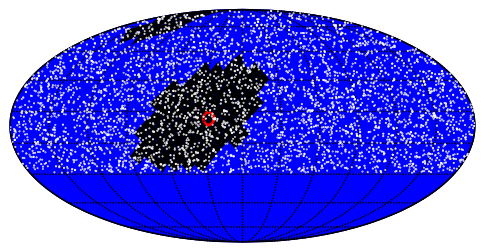

In [123]:
vf.generate_image(1, df, snsims=simsdf)

/usr/local/miniconda/lib/python2.7/site-packages/ipykernel/__main__.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/miniconda/lib/python2.7/site-packages/ipykernel/__main__.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/miniconda/lib/python2.7/site-packages/ipykernel/__main__.py:116: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable

([<matplotlib.figure.Figure at 0x1112b1610>,
 [1, 2, 3, 4])

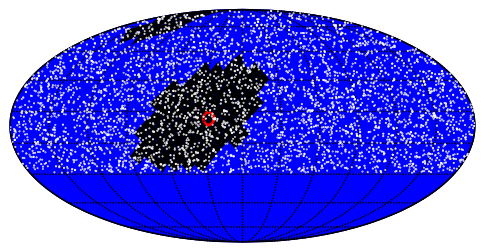

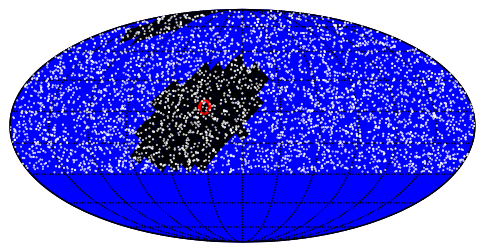

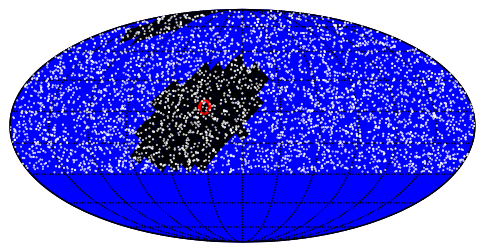

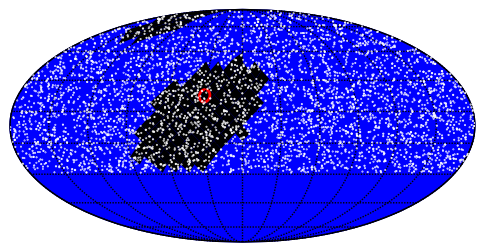

In [125]:
vf.generate_images([1,2,3,4] , df, snsims=simsdf, savefig=True, outdir='/Users/rbiswas/tmp/ztf_figs/')

In [127]:
import ephem

In [128]:
observer = ephem.Observer()
observer.long, observer.lat = '-116:51:50', '33:21:21'
observer.elevation = 1712

In [130]:
moon = ephem.Moon()

In [132]:
moon.compute()

In [ ]:
moon.

In [85]:
vf.filenameFromMjd(df.expMJD.min())

'/Users/rbiswas/doc/projects/ZTF/data_year/2458121.da'

In [93]:
vf.pixel_patches(df.expMJD.min(), m)

NameError: name 'm' is not defined

In [86]:
vf.fieldCoords(df.expMJD.min())

,ra,dec,start,end,on
ind,,,,,
0,-180.00000,-86.30098,58121.035417,58121.035417,0
1,-172.24995,-86.30098,58121.035417,58121.035417,0
2,-117.42345,-86.30098,58121.035417,58121.035417,0
3,-109.67340,-86.30098,58121.035417,58121.035417,0
4,-54.84465,-86.30098,58121.035417,58121.035417,0
5,-47.09460,-86.30098,58121.035417,58121.035417,0
6,7.71600,-86.30098,58121.035417,58121.035417,0
7,15.46605,-86.30098,58121.035417,58121.035417,0
8,70.27560,-86.30098,58121.035417,58121.035417,0


In [63]:
list(vf._minutes_since_noon2mjd(df.expMJD.min(), v) for v in vf.fieldCoords(df.expMJD.min()).query('on == 1').end.values)

[58121.08541666667,
 58121.086805555555,
 58121.097916666666,
 58121.09930555556,
 58121.10972222222,
 58121.11111111111,
 58121.12222222222,
 58121.123611111114,
 58121.13402777778,
 58121.135416666664,
 58121.146527777775,
 58121.14791666667,
 58121.15833333333,
 58121.15972222222,
 58121.17083333333,
 58121.17222222222,
 58121.18263888889,
 58121.18402777778,
 58121.19513888889,
 58121.19652777778,
 58121.20694444444,
 58121.208333333336,
 58121.21944444445,
 58121.22083333333,
 58121.23125,
 58121.23263888889,
 58121.243055555555,
 58121.24513888889,
 58121.25555555556,
 58121.256944444445,
 58121.26736111111,
 58121.26944444444,
 58121.279861111114,
 58121.28125,
 58121.291666666664,
 58121.29305555556,
 58121.48611111111,
 58121.4875,
 58121.498611111114,
 58121.5,
 58121.510416666664,
 58121.51180555556,
 58121.52291666667,
 58121.524305555555,
 58121.53472222222,
 58121.53611111111,
 58121.08819444444,
 58121.089583333334,
 58121.1,
 58121.10138888889,
 58121.111805555556,
 581

In [62]:
vf.fieldCoords(df.expMJD.min()).query('on == 1').end.values

count    1103.000000
mean      828.522212
std       245.654537
min       412.000000
25%       599.000000
50%       782.000000
75%      1074.000000
max      1074.000000
Name: end, dtype: float64

In [33]:
vf.fieldCoords(df.expMJD.min()).head()

,ra,dec,start,end,on
ind,,,,,
0,-180.00000,-86.30098,351,351,0
1,-172.24995,-86.30098,351,351,0
2,-117.42345,-86.30098,351,351,0
3,-109.67340,-86.30098,351,351,0
4,-54.84465,-86.30098,351,351,0


In [114]:
ls = list(datetime.timedelta(minutes=minv) for minv in vf.fieldCoords(57391.1).query('on == 1').start.values) 

In [126]:
from astropy.time import TimezoneInfo
import astropy.units as u

In [127]:
pt = TimezoneInfo(utc_offset=1*u.hour)

In [316]:
from astropy.time import Time, TimeDelta

In [49]:
dt = Time(np.floor(57391), format='mjd')
DeltaT = TimeDelta(-5 * 3600 + 349*60, format='sec')

In [50]:
xy = dt +  DeltaT

In [51]:
xy.jd

2457391.5340277776

In [45]:
349 // 60

5

In [44]:
349 % 60

49

In [149]:
time.TimeDelta(hours= 347//60, minute=347%60)

TypeError: __new__() got an unexpected keyword argument 'hours'

In [143]:
dt_aware = datetime.datetime(2018, 1, 4, 12, 0, 0, tzinfo=pt)

In [141]:
dt_aware

datetime.datetime(2018, 1, 4, 2, 24, tzinfo=<astropy.time.formats.TimezoneInfo object at 0x10e4ef210>)

In [116]:
datetime.time

AttributeError: 'module' object has no attribute 'mjd'

NameError: global name 'Planck15' is not defined

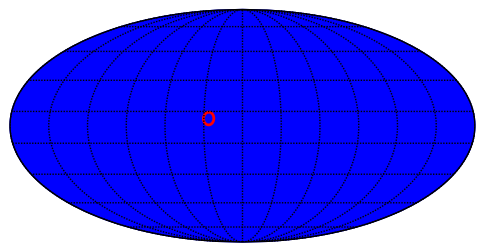

In [91]:
fig, ax, m  = vf.generate_image(1, df, snsims=simsdf)

/usr/local/miniconda/lib/python2.7/site-packages/ipykernel/__main__.py:100: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/miniconda/lib/python2.7/site-packages/ipykernel/__main__.py:101: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/miniconda/lib/python2.7/site-packages/ipykernel/__main__.py:102: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable

([<matplotlib.figure.Figure at 0x1773f2e10>,
 [1, 2])

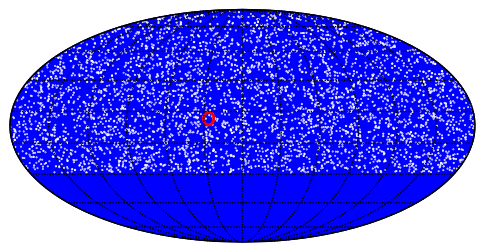

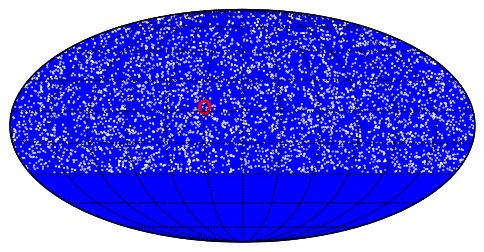

In [310]:
vf.generate_images([1, 2], df, snsims=simsdf)

In [158]:
from copy import deepcopy

In [235]:
simsdf.head()

,z,ra,dec,t0
0,0.150856,177.009298,-9.541729,58158.737911
1,0.193961,-142.895644,-16.445698,58171.555313
2,0.185266,104.668543,5.147820,58304.201365
3,0.101136,93.239688,81.126166,58232.383343
4,0.137615,39.767127,0.367004,58192.249369


In [199]:
from astropy.cosmology import Planck15

In [251]:
xx = vf.sn_scatter(1, df, simsdf)

/usr/local/miniconda/lib/python2.7/site-packages/ipykernel/__main__.py:95: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/miniconda/lib/python2.7/site-packages/ipykernel/__main__.py:96: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/miniconda/lib/python2.7/site-packages/ipykernel/__main__.py:97: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/in

In [252]:
xx.describe()

,z,ra,dec,t0,time,mag,x0,rad
count,4083.000000,4083.000000,4083.000000,4083.000000,4083.000000,4083.000000,4083.000000,4083.000000
mean,0.147108,-0.151445,16.054933,58134.587195,-13.440810,19.839582,0.000271,0.216042
std,0.039516,104.700574,28.650523,9.456739,9.456739,0.763714,0.000502,0.076371
min,0.022837,-179.996135,-29.988178,58118.505713,-29.975939,15.860105,0.000081,0.133914
25%,0.120248,-89.244026,-7.580215,58126.340109,-21.569092,19.457368,0.000104,0.159546
50%,0.155529,-0.495447,13.344543,58134.396575,-13.250190,20.064433,0.000142,0.193557
75%,0.179254,91.531916,37.806040,58142.715476,-5.193725,20.404541,0.000248,0.254263
max,0.199993,179.959678,86.790100,58151.122323,2.640672,20.660856,0.007882,0.613989


In [253]:
xx.dec.values

array([ 34.83414498,  71.29035199,  25.32449899, ..., -17.88623875,
        23.15320014,  48.34371304])

In [254]:
xx.ra.describe()

count    4083.000000
mean       -0.151445
std       104.700574
min      -179.996135
25%       -89.244026
50%        -0.495447
75%        91.531916
max       179.959678
Name: ra, dtype: float64

In [255]:
xx.ra.values

array([ -80.27968153, -116.82669515,  111.68563567, ...,   94.87228255,
        -35.30883653, -116.24813145])

In [298]:
x, y = m(xx.ra.values, xx.dec.values)
ax.scatter(x, y, s=xx.rad.values, c='w', edgecolors='w')

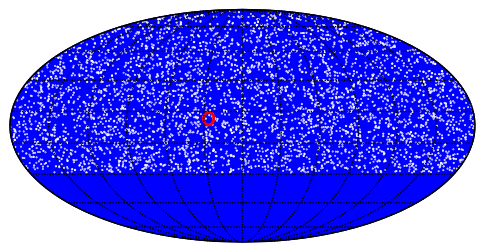

In [299]:
fig

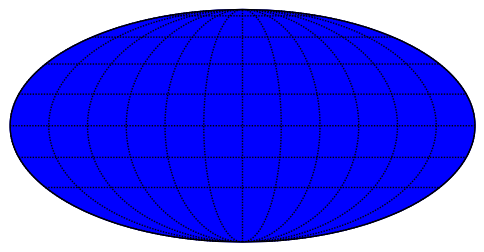

In [280]:
fig2, ax2 = plt.subplots()
mm = Basemap(#llcrnrlat=-32., llcrnrlon=48.,
            #urcrnrlat=-22., urcrnrlon=58,
            projection='moll', lon_0=0., lat_0=0., ax=ax2)
_ = mm.drawparallels(np.arange(-40.,91.,20.))
_ = mm.drawmeridians(np.arange(-180., 181., 30.))
_ = mm.drawmapboundary(color='blue', fill_color='b')

In [281]:
x, y = mm(xx.ra.values, xx.dec.values)

In [282]:
ax2.scatter(x, y, s=xx.rad.values, color='y')

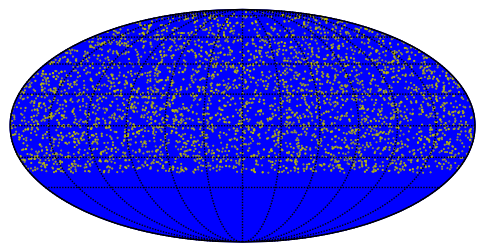

In [283]:
fig2

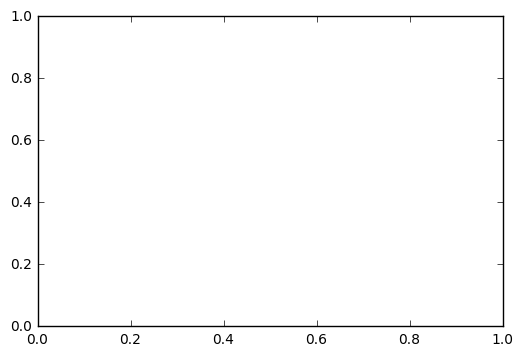

In [240]:
fig, ax = plt.subplots()

In [241]:
ax.scatter(xx.ra, xx.dec)

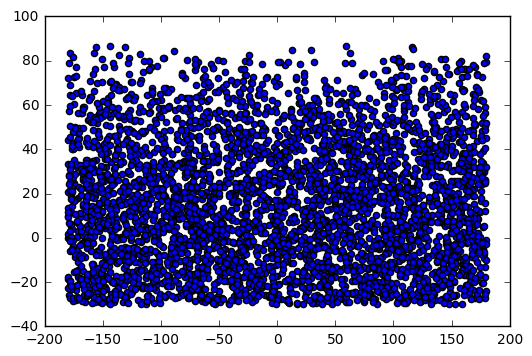

In [242]:
fig

In [202]:
xx.describe()

,z,ra,dec,t0,time,mag,x0,rad
count,4083.000000,4083.000000,4083.000000,4083.000000,4083.000000,4083.000000,4083.000000,4083.000000
mean,0.147108,-182.271674,16.054933,58134.587195,-13.440810,19.839582,0.000271,0.216042
std,0.039516,1570.508616,28.650523,9.456739,9.456739,0.763714,0.000502,0.076371
min,0.022837,-2879.942023,-29.988178,58118.505713,-29.975939,15.860105,0.000081,0.133914
25%,0.120248,-1518.660388,-7.580215,58126.340109,-21.569092,19.457368,0.000104,0.159546
50%,0.155529,-187.431699,13.344543,58134.396575,-13.250190,20.064433,0.000142,0.193557
75%,0.179254,1192.978743,37.806040,58142.715476,-5.193725,20.404541,0.000248,0.254263
max,0.199993,2519.395172,86.790100,58151.122323,2.640672,20.660856,0.007882,0.613989


In [166]:
import sncosmo

/usr/local/miniconda/lib/python2.7/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


(<class 'matplotlib.figure.Figure'>, '/Users/rbiswas/tmp/ztf_figs/ztf_obsHistID_000001.png')
(<class 'matplotlib.figure.Figure'>, '/Users/rbiswas/tmp/ztf_figs/ztf_obsHistID_000002.png')
(<class 'matplotlib.figure.Figure'>, '/Users/rbiswas/tmp/ztf_figs/ztf_obsHistID_000003.png')
(<class 'matplotlib.figure.Figure'>, '/Users/rbiswas/tmp/ztf_figs/ztf_obsHistID_000004.png')
(<class 'matplotlib.figure.Figure'>, '/Users/rbiswas/tmp/ztf_figs/ztf_obsHistID_000005.png')
(<class 'matplotlib.figure.Figure'>, '/Users/rbiswas/tmp/ztf_figs/ztf_obsHistID_000006.png')
(<class 'matplotlib.figure.Figure'>, '/Users/rbiswas/tmp/ztf_figs/ztf_obsHistID_000007.png')
(<class 'matplotlib.figure.Figure'>, '/Users/rbiswas/tmp/ztf_figs/ztf_obsHistID_000008.png')
(<class 'matplotlib.figure.Figure'>, '/Users/rbiswas/tmp/ztf_figs/ztf_obsHistID_000009.png')
(<class 'matplotlib.figure.Figure'>, '/Users/rbiswas/tmp/ztf_figs/ztf_obsHistID_000010.png')
(<class 'matplotlib.figure.Figure'>, '/Users/rbiswas/tmp/ztf_figs/ztf_

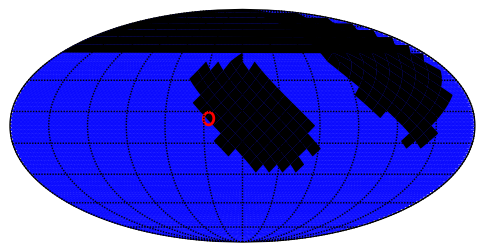

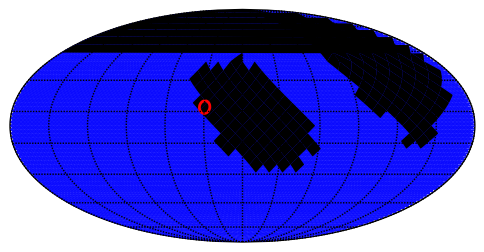

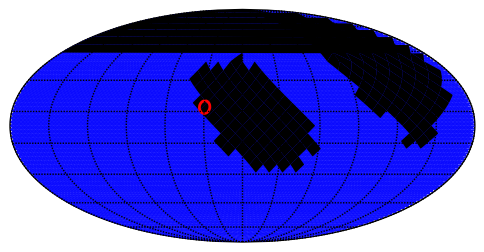

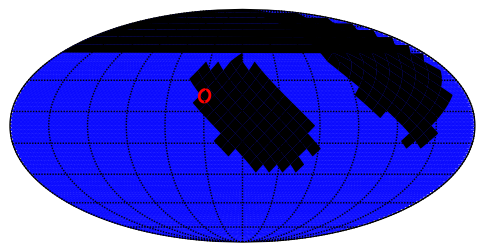

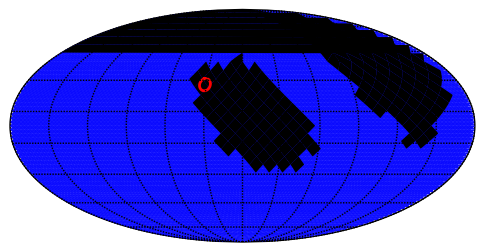

...

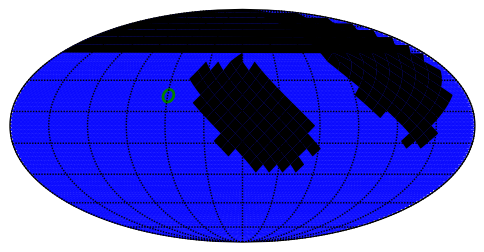

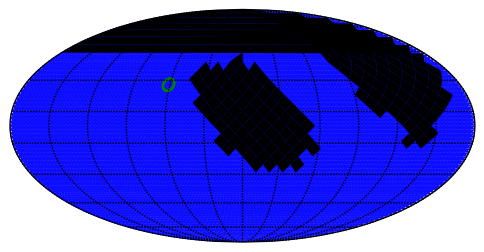

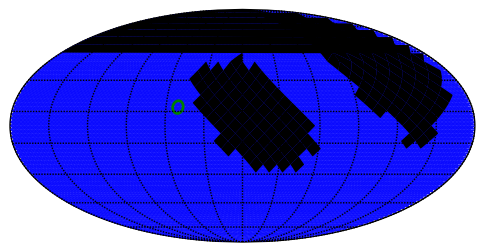

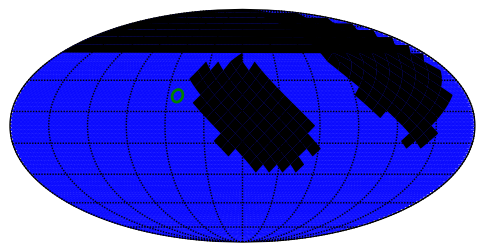

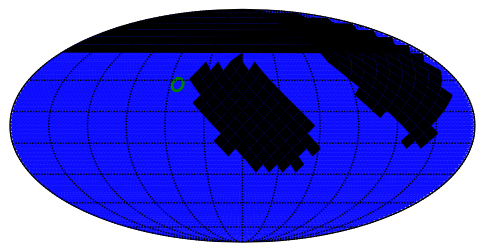

In [28]:
#!mkdir -p /Users/rbiswas/tmp/ztf_figs
figs = vf.generate_images(np.arange(1, 100), df, outdir='/Users/rbiswas/tmp/ztf_figs', savefig=True)

(<class 'matplotlib.figure.Figure'>, '/Users/rbiswas/tmp/ztf_figs/ztf_obsHistID_000100.png')
(<class 'matplotlib.figure.Figure'>, '/Users/rbiswas/tmp/ztf_figs/ztf_obsHistID_000101.png')
(<class 'matplotlib.figure.Figure'>, '/Users/rbiswas/tmp/ztf_figs/ztf_obsHistID_000102.png')
(<class 'matplotlib.figure.Figure'>, '/Users/rbiswas/tmp/ztf_figs/ztf_obsHistID_000103.png')
(<class 'matplotlib.figure.Figure'>, '/Users/rbiswas/tmp/ztf_figs/ztf_obsHistID_000104.png')
(<class 'matplotlib.figure.Figure'>, '/Users/rbiswas/tmp/ztf_figs/ztf_obsHistID_000105.png')
(<class 'matplotlib.figure.Figure'>, '/Users/rbiswas/tmp/ztf_figs/ztf_obsHistID_000106.png')
(<class 'matplotlib.figure.Figure'>, '/Users/rbiswas/tmp/ztf_figs/ztf_obsHistID_000107.png')
(<class 'matplotlib.figure.Figure'>, '/Users/rbiswas/tmp/ztf_figs/ztf_obsHistID_000108.png')
(<class 'matplotlib.figure.Figure'>, '/Users/rbiswas/tmp/ztf_figs/ztf_obsHistID_000109.png')
(<class 'matplotlib.figure.Figure'>, '/Users/rbiswas/tmp/ztf_figs/ztf_

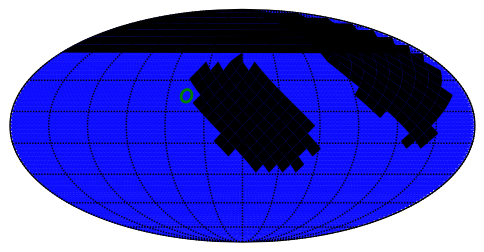

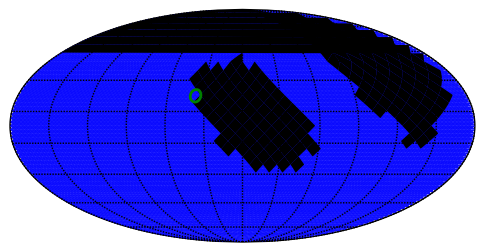

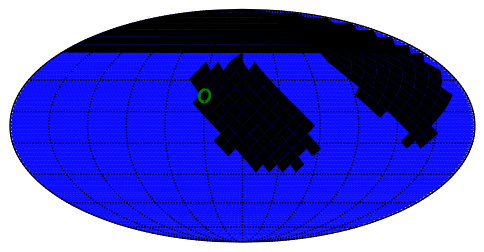

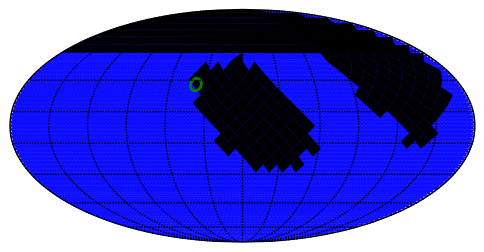

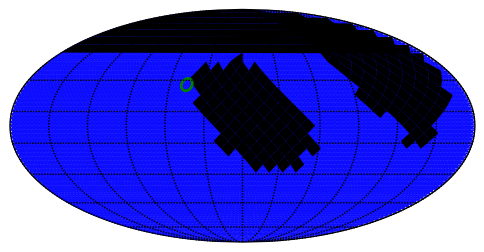

...

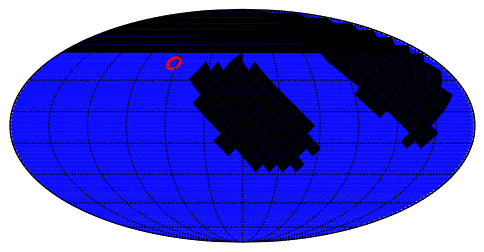

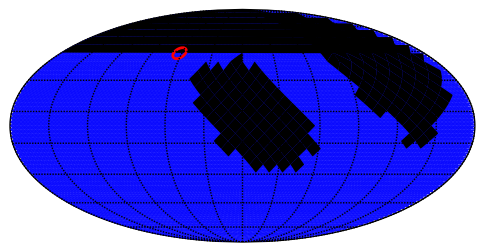

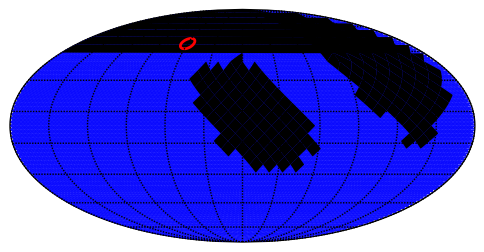

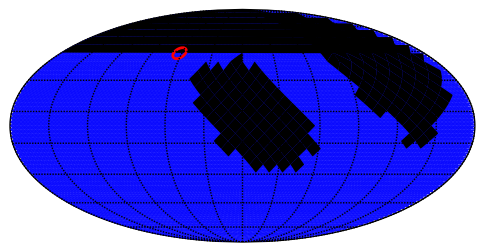

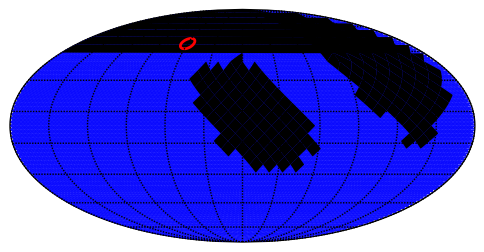

In [29]:
figs2 = vf.generate_images(np.arange(100, 150), df, outdir='/Users/rbiswas/tmp/ztf_figs', savefig=True)

# Scratch

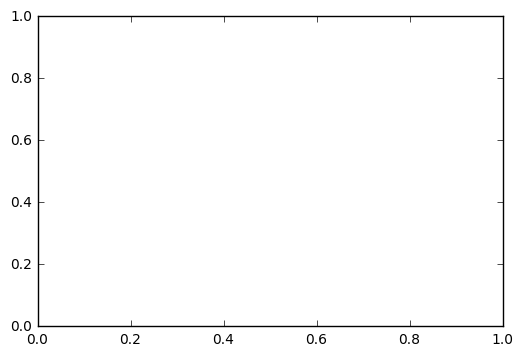

In [33]:
fig, ax = plt.subplots()

In [41]:
figs[0]

In [42]:
figs[1]

array([1])

In [43]:
fname = os.path.join('/Users/rbiswas/tmp/ztf_figs/',
                     'ztf_obsHistID_{:d}.png'.format(np.int(1)))

In [44]:
fname

'/Users/rbiswas/tmp/ztf_figs/ztf_obsHistID_1.png'

In [46]:
for fig, obsHistID in zip(figs[0], figs[1]):
    fname = os.path.join('/Users/rbiswas/tmp/ztf_figs/',
                         'ztf_obsHistID_{:d}.png'.format(np.int(obsHistID)))
    print(fname)
    fig.savefig(fname)

/Users/rbiswas/tmp/ztf_figs/ztf_obsHistID_1.png


In [28]:
figs[0].savefig(os.path.join('/Users/rbiswas/tmp/ztf_figs/', 'test.png'))

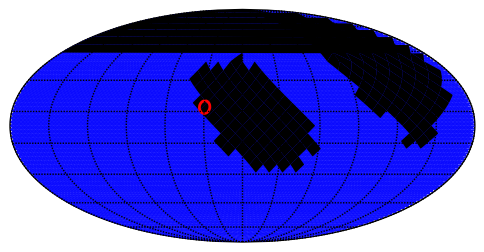

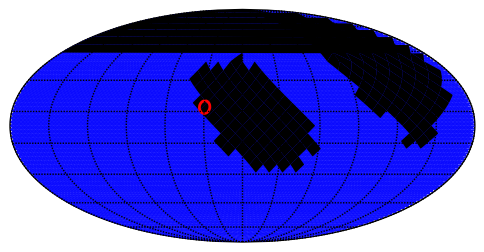

In [46]:
vf.generate_image(1, df)

In [222]:
xx = vf.fieldCoords(df.expMJD.min())

In [ ]:
ra = xx.ra
dec = xx.dec
theta, phi = oss.

In [142]:
import healpy as hp

In [144]:
import opsimsummary as oss

In [152]:
hp.nside2pixarea(8, degrees=True)

53.714793293514674

In [155]:
hpt = oss.HealpixTiles(nside=64, opsimdf=df, fovRadius=)

In [199]:
xx = vf.fieldCoords(df.expMJD.min())
theta, phi = oss.convertToSphericalCoordinates(ra=xx.ra, dec=xx.dec)

array([640, 640, 640, ...,  63, 127, 127])

In [215]:
ipix = np.unique(hp.ang2pix(16, theta, phi, nest=True))
ipix.sort()

In [216]:
len(ipix)

2418

In [218]:
hp.nside2npix(16)

3072

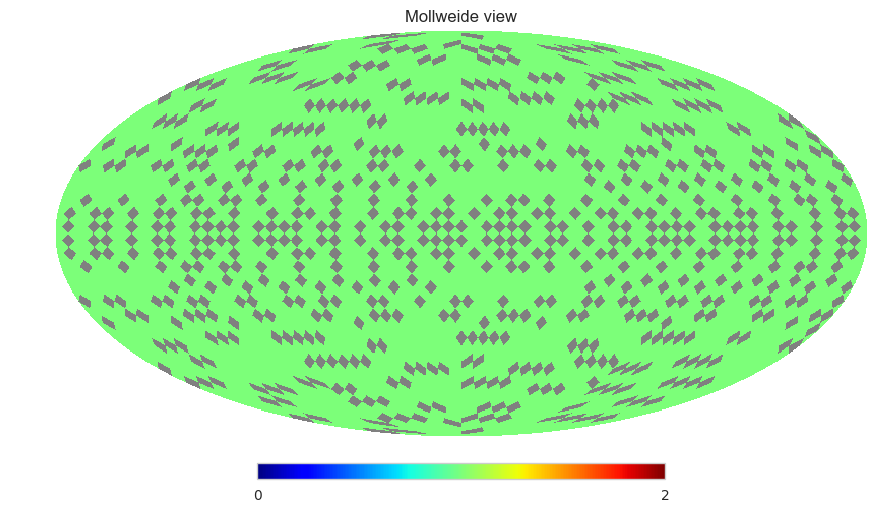

In [219]:
arr = np.ones(hp.nside2npix(16)) * hp.UNSEEN
arr[ipix] = 1
hp.mollview(arr, nest=True)

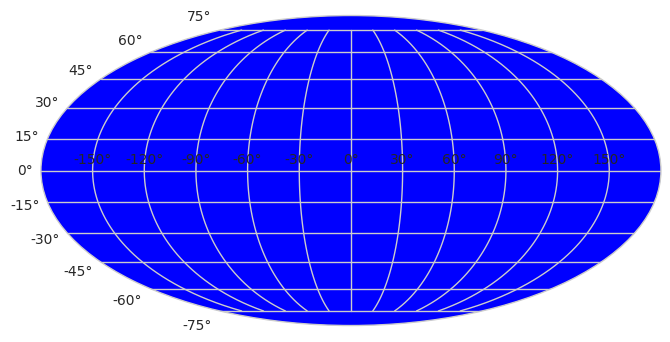

In [212]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='mollweide', axisbg='blue')#,color='blue')#, celestial=True)

In [158]:
hpt.tileIDsForSN()

<bound method HealpixTiles.tileIDsForSN of <opsimsummary.healpixTiles.HealpixTiles object at 0x117a16ed0>>

In [ ]:
oss.HPTileVis()

In [174]:
vf = VisibleFields('/Users/rbiswas/doc/projects/ZTF/data_year/')

In [175]:
2457967/ 2400000.5

1.02415270330152

In [176]:
df.expMJD.min()  + 2400000.5 - dates.min()

-575.3536157021299

In [177]:
vf.filenameFromMjd(df.expMJD.min())

'/Users/rbiswas/doc/projects/ZTF/data_year/2457967.da'

In [178]:
dates.min()

2457967.0

In [179]:
(59580 - df.expMJD.min()) / 365.0

5.9968592211018059

In [180]:
pd.read_csv()

TypeError: parser_f() takes at least 1 argument (0 given)

In [71]:
import glob

In [81]:
'2457978.da'.strip('.da')

'2457978'

In [100]:
np.diff(dates)

array([ 1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
        1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
        1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
        1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
        1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
        1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
        1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
        1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
        1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
        1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
        1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
        1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
        1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
        1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1

In [92]:
dates.min() - 2400000.5 - df.expMJD.min()

575.353615702159

In [93]:
import ephem

In [95]:
obs = ephem.Observer()

In [97]:
from ephem import cities

In [99]:
cities._city_data.keys()

['Kiev',
 'Lille',
 'Paris',
 'Oslo',
 'Rio de Janeiro',
 'Johannesburg',
 'San Francisco',
 'Sao Paulo',
 'Santiago',
 'Abu Dhabi',
 'Hamburg',
 'Atlanta',
 'Brussels',
 'Dubai',
 'Miami',
 'Dublin',
 'Rome',
 'St. Petersburg',
 'Marseille',
 'Taipei',
 'Brisbane',
 'Cairo',
 'Osaka',
 'Washington',
 'Minneapolis',
 'Cologne',
 'Milan',
 'Manchester',
 'Seattle',
 'Caracas',
 'Auckland',
 'Sydney',
 'Ho Chi Minh City',
 'Vienna',
 'Edinburgh',
 'Seoul',
 'Singapore',
 'Moscow',
 'Guangzhou',
 'Kuala Lumpur',
 'Berlin',
 'Leeds',
 'Los Angeles',
 'Tehran',
 'London',
 'Bangalore',
 'Cape Town',
 'Kansas City',
 'Stuttgart',
 'Bologna',
 'Frankfurt',
 'New Delhi',
 'Zurich',
 'Madrid',
 'Boston',
 'Utrecht',
 'Adelaide',
 'Mexico City',
 'Lyon',
 'Istanbul',
 'Dallas',
 'Hanoi',
 'Luxembourg',
 'Richmond',
 'Manila',
 'Calgary',
 'Rotterdam',
 'Turin',
 'Columbus',
 'Mumbai',
 'Bratislava',
 'Hong Kong',
 'Toronto',
 'Tokyo',
 'Wellington',
 'Detroit',
 'Philadelphia',
 'Stockholm',
 'T

In [89]:
dates - df.expMJD.unique()

array([ 2400575.8536157,  2400576.8536157,  2400577.8536157,
        2400578.8536157,  2400579.8536157,  2400580.8536157,
        2400581.8536157,  2400582.8536157,  2400583.8536157,
        2400584.8536157,  2400585.8536157,  2400586.8536157,
        2400587.8536157,  2400588.8536157,  2400589.8536157,
        2400590.8536157,  2400591.8536157,  2400592.8536157,
        2400593.8536157,  2400594.8536157,  2400595.8536157,
        2400596.8536157,  2400597.8536157,  2400598.8536157,
        2400599.8536157,  2400600.8536157,  2400601.8536157,
        2400602.8536157,  2400603.8536157,  2400604.8536157,
        2400605.8536157,  2400606.8536157,  2400607.8536157,
        2400608.8536157,  2400609.8536157,  2400610.8536157,
        2400611.8536157,  2400612.8536157,  2400613.8536157,
        2400614.8536157,  2400615.8536157,  2400616.8536157,
        2400617.8536157,  2400618.8536157,  2400619.8536157,
        2400620.8536157,  2400621.8536157,  2400622.8536157,
        2400623.8536157,

In [78]:
2457967 - 57572

2400395

In [76]:
df.expMJD.describe()

count    174854.000000
mean      57572.598386
std         108.754394
min       57391.146384
25%       57472.340858
50%       57577.261935
75%       57668.260618
max       57752.578109
Name: expMJD, dtype: float64

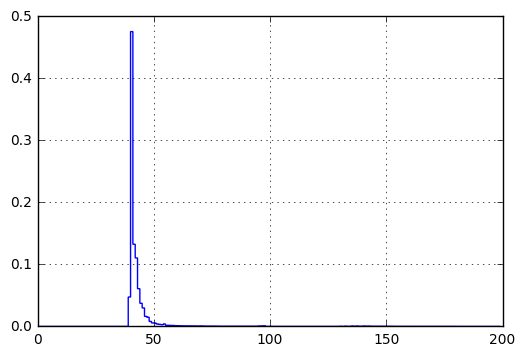

In [41]:
df.expMJD.apply(lambda x: x * 24* 3600).diff().hist(bins=np.arange(0., 200, 1), histtype='step', normed=1)

In [44]:
import seaborn as sns
sns.set_style('whitegrid')

In [49]:
df.head()

,sessionID,propID,fieldID,fieldRA,fieldDec,filter,expDate,expMJD,night,visitTime,...,rawSeeing,wind,humidity,slewDist,slewTime,fiveSigmaDepth,ditheredRA,ditheredDec,totalRequestsTonight,metricValue
obsHistID,,,,,,,,,,,,,,,,,,,,,
1,0,2,450,0.458529,0.079412,r,271847,57391.146384,3,30.0,...,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,2,0.0
2,0,2,503,0.518548,0.205076,r,271887,57391.146847,3,30.0,...,NaN,NaN,NaN,0.138983,10.000000,0.0,0.0,0.0,2,0.0
3,0,1,503,0.518548,0.205076,r,271927,57391.147310,3,30.0,...,NaN,NaN,NaN,0.000000,10.000000,0.0,0.0,0.0,4,0.0
4,0,1,554,0.530136,0.330740,r,271967,57391.147773,3,30.0,...,NaN,NaN,NaN,0.126159,10.000000,0.0,0.0,0.0,4,0.0
5,0,3,604,0.542169,0.456404,r,272010,57391.148274,3,30.0,...,NaN,NaN,NaN,0.126153,13.299357,0.0,0.0,0.0,3,0.0


In [58]:
import matplotlib.pyplot as plt

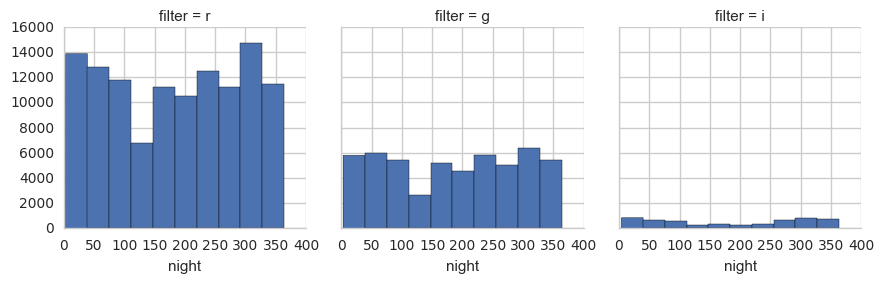

In [69]:
g = sns.FacetGrid(df, col='filter')
g.map(plt.hist, 'night')

In [5]:
ztf_scheduler = OpSimOutput.fromOpSimDB(, tableNames=('Summary'), 
                                        subset='_all')

 reading from database sqlite:////Users/rbiswas/Downloads/test_schedule_v3.db


ValueError: Table Proposal not found

###  Demo showing that a healpy mollview plot matches points claimed as boundaries

In [5]:
ipix  = np.array([11])

In [6]:
lon, lat = healpix_boundaries(ipix, nside=4, units='radians', nest=True, step=2)

The return of this funciton is a tuple of lon and lat

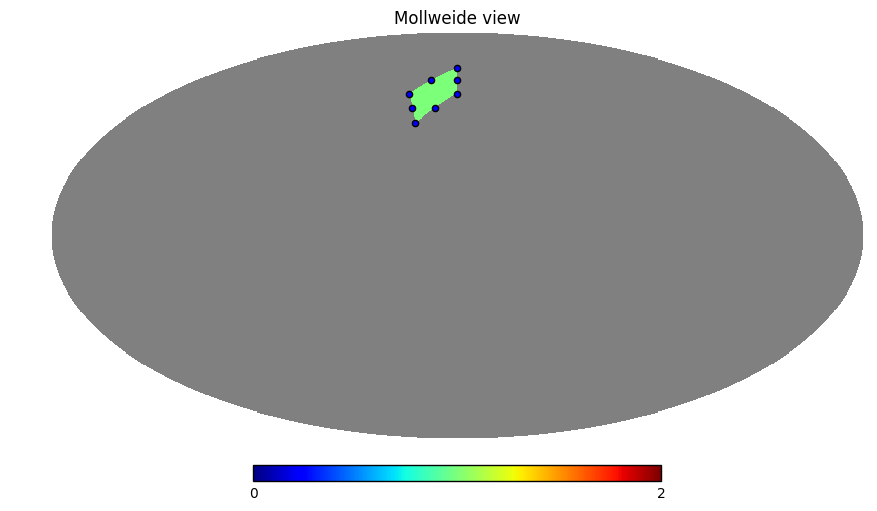

In [7]:
arr = np.ones(hp.nside2npix(4)) * hp.UNSEEN
arr[ipix] = 1
hp.mollview(arr, nest=True)
hp.projscatter(lat, lon)

How to get more points?

In [8]:
lon, lat = healpix_boundaries(ipix, nside=4, units='radians', nest=True, step=3)

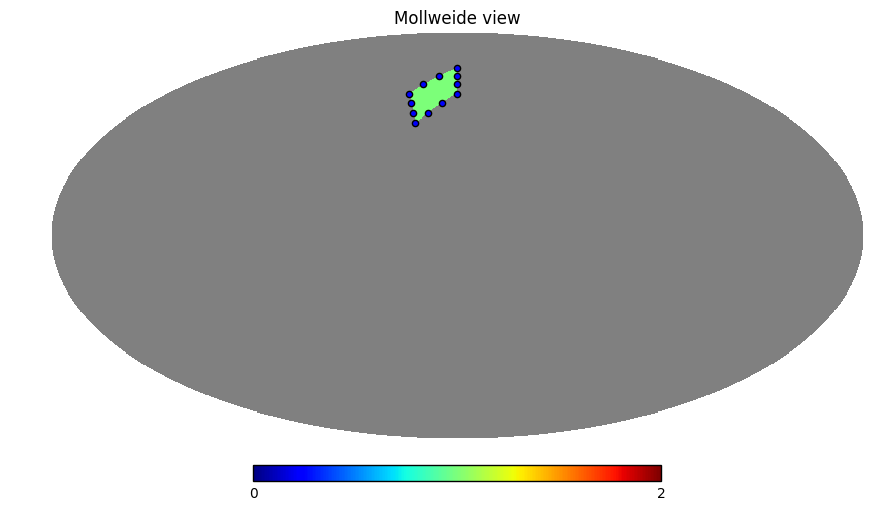

In [9]:
arr = np.ones(hp.nside2npix(4)) * hp.UNSEEN
arr[ipix] = 1
hp.mollview(arr, nest=True)
hp.projscatter(lat, lon)

In [10]:
lon

array([ 0.        ,  0.        ,  0.        ,  0.        ,  0.15707963,
        0.28559933,  0.39269908,  0.428399  ,  0.4712389 ,  0.52359878,
        0.39269908,  0.22439948])

###  Draw a Healpix in basemap

In [11]:
from opsimsummary import HPTileVis, HealpixTiles

In [12]:
hptiles = HealpixTiles(preComputedMap='/Users/rbiswas/data/LSST/OpSimData/healpixelized_MINION_1016_256_64_indexed.db',
                       nside=256)

In [13]:
hptvis = HPTileVis(hptiles, None)

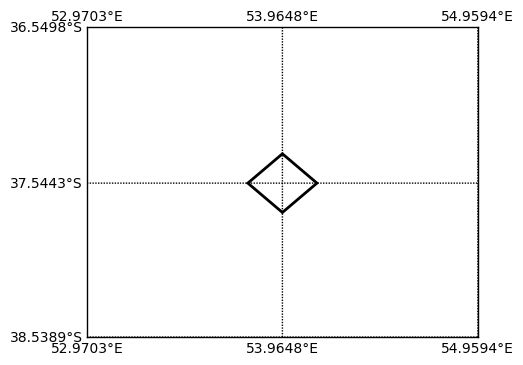

In [14]:
fig, tile_center, _  = hptvis.plotTilePointings((552466), projection='cea', paddingFactors=0.5, ax=None,drawPointings=False
                        ,
                                       **dict(fill=False, color='g', alpha=0.01)
                         )

In [15]:
hp.get_all_neighbours(256,theta=552466, nest=True)

array([552455, 552461, 552472, 552473, 552467, 552465, 552464, 552453])

In [16]:
for ipix in hp.get_all_neighbours(256, theta=552466, nest=True):
    _, _, _ = hptvis.plotTilePointings(ipix, tile_centers=tile_center, projection='cea', paddingFactors=0.5, ax=fig.axes[0],drawPointings=False
                        ,
                                       **dict(fill=False, color='g', alpha=0.01)
                         )

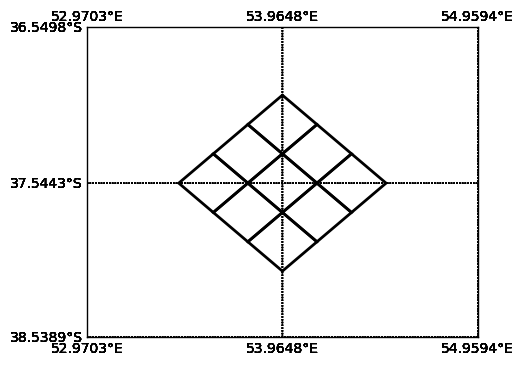

In [17]:
fig

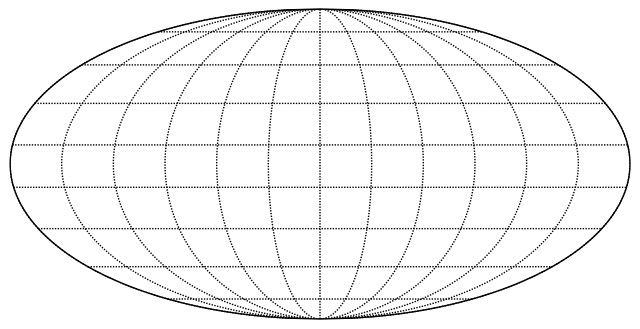

In [412]:
fig, ax = plt.subplots()
m = Basemap(#llcrnrlat=-32., llcrnrlon=48.,
            #urcrnrlat=-22., urcrnrlon=58,
            projection='moll', lon_0=0., lat_0=0., ax=ax)
_ = m.drawparallels(np.arange(-91.,91.,20.))
_ = m.drawmeridians(np.arange(-180., 181., 30.))


In [ ]:
visible

In [230]:
xx.ra.max()

179.96145000000001

In [231]:
xx.dec.min()

-86.300979999999996

In [232]:
xx.dec.max()

86.300979999999996

In [373]:
vf = VisibleFields('/Users/rbiswas/doc/projects/ZTF/data_year/')

In [496]:
_allpatches = vf.pixel_patches(df.expMJD.min(), m=m, nside=16, facecolor='b', alpha=0.4, 
                               ipix=np.arange(hp.nside2npix(16)))

In [497]:
_ = list(ax.add_patch(patch)for patch in _allpatches)

In [361]:
patches = vf.pixel_patches(mjd=df.expMJD.min(), m=m, nside=8, facecolor='k', alpha=0.8)

In [371]:
hp.nside2npix(1)

12

In [383]:
len(_allpatches)

12

In [386]:
_allpatches[1]

In [418]:
xx = vf.pixel_patches(df.expMJD.min(), m=m, nside=1, facecolor='b', alpha=1, ipix=[2])

In [419]:
list(ax.add_patch(xxx) for xxx in xx)

In [420]:
healpix_boundaries(2, nside=1, step=1, )

(array([   0.,  180.,  225.,  270.]),
 array([  0.       ,  48.1896851,  90.       ,  48.1896851]))

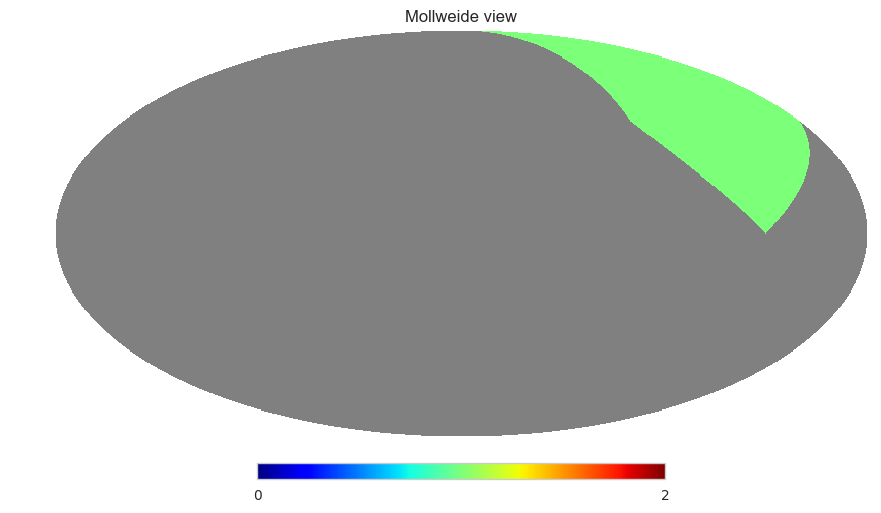

In [441]:
ipix=np.ones(12)* hp.UNSEEN
ipix[2] = 1
hp.mollview(ipix, nest=True, flip='astro')

In [584]:
vf = VisibleFields('/Users/rbiswas/doc/projects/ZTF/data_year')

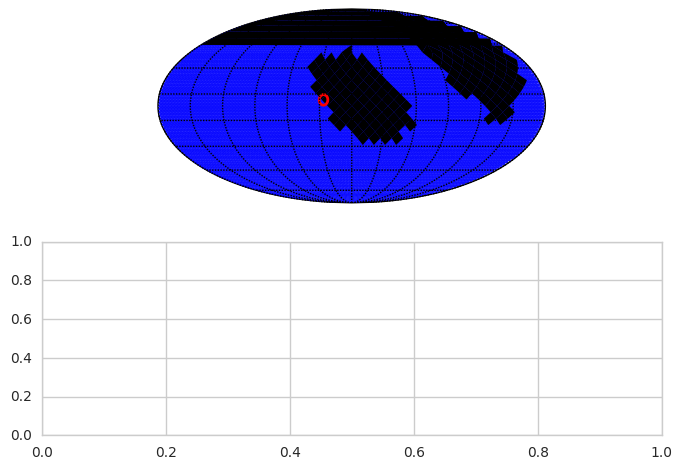

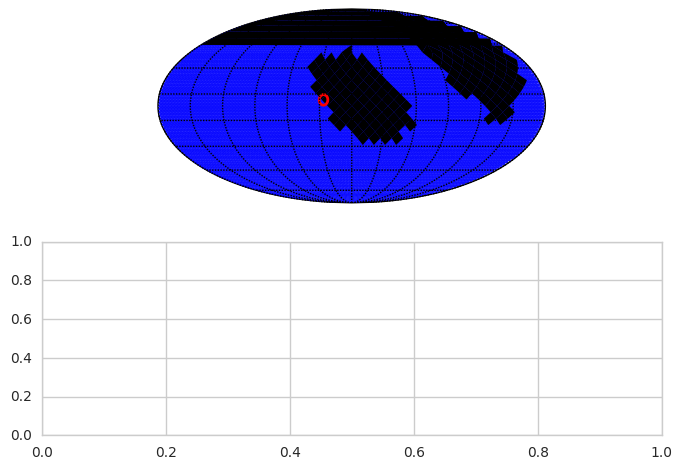

In [585]:
vf.generate_image(1, df)

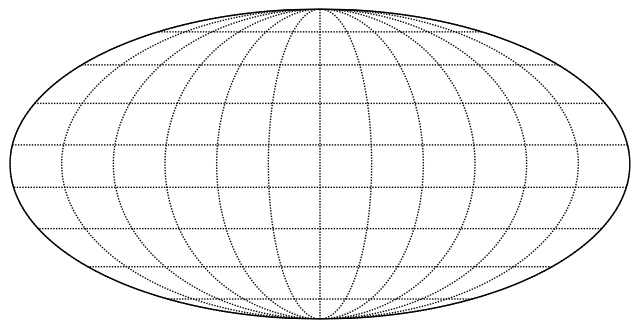

In [539]:
fig, ax = plt.subplots()
m = Basemap(#llcrnrlat=-32., llcrnrlon=48.,
            #urcrnrlat=-22., urcrnrlon=58,
            projection='moll', lon_0=0., lat_0=0., ax=ax, celestial=True)
_ = m.drawparallels(np.arange(-91.,91.,20.))
_ = m.drawmeridians(np.arange(-180., 181., 30.))
#lon, lat = healpix_boundaries([2], nside=1, step=10, nest=True)
#x, y = m(lon, lat)
#xy = zip(x, y)
#xx  = Polygon(xy)
#xx = vf.pixel_patches(df.expMJD.min(), m=m, nside=1, facecolor='b', alpha=1, ipix=[2])
#list(ax.add_patch(xxx) for xxx in xx)

In [525]:
_allpatches = vf.pixel_patches(df.expMJD.min(), m=m, nside=32, facecolor='b', alpha=0.8, 
                               ipix=np.arange(hp.nside2npix(32)))

In [526]:
_ = list(ax.add_patch(patch)for patch in _allpatches)

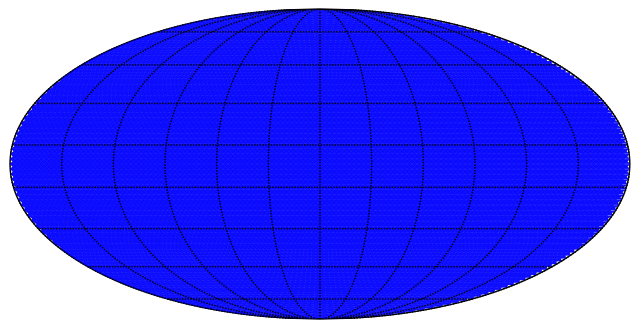

In [527]:
fig

In [540]:
vispatches = vf.pixel_patches(mjd=df.expMJD.min(), m=m, nside=8)

In [541]:
_ = list(ax.add_patch(patch) for patch in vispatches)

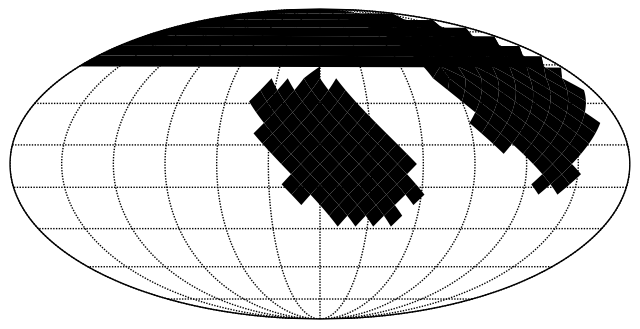

In [542]:
fig

In [536]:
NSIDE=8
ipixs = np.ones(hp.nside2npix(NSIDE))*hp.UNSEEN
ipixs[vf.healpixels(mjd=df.expMJD.min(),nside=NSIDE)]=1

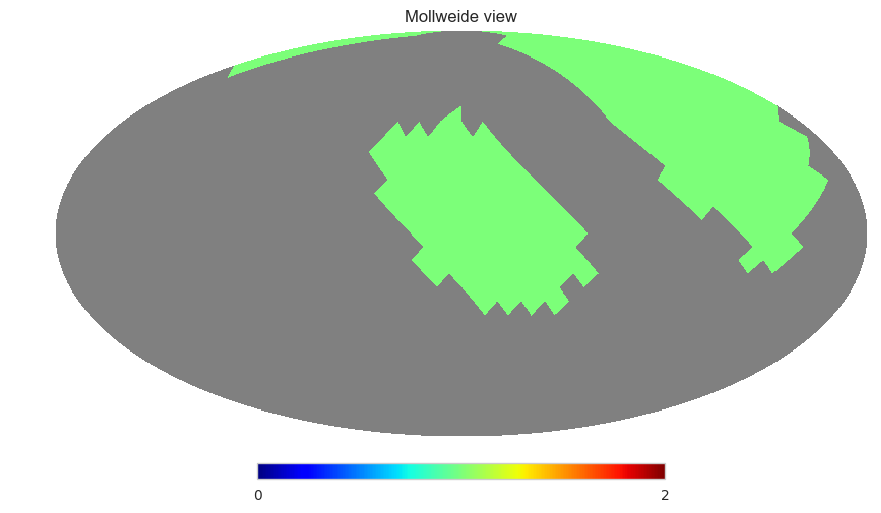

In [538]:
hp.mollview(ipixs, nest=True, flip='astro')

In [327]:
ipix = vf.healpixels(mjd=df.expMJD.min(),nside=8)

In [305]:
theta, phi = oss.healpix_boundaries(ipix[0], nside=8, nest=True)

In [543]:
import ephem

33.350000000000001

In [547]:
lat = np.dot(np.array([33., 21.,0.0]) , np.array([1, 1./60., 1./3600.]))
lon = np.dot(np.array([-116,51,50.0]), np.array([1., 1./60., 1./3600.]))
obs = ephem.Observer()

In [548]:
obs.lat = lat
obs.lon = lon
obs.elevation = 1712

In [553]:
from datetime import datetime
import pytz

In [558]:
dt = datetime.now()

In [567]:
obs.epoch.datetime()

datetime.datetime(2000, 1, 1, 12, 0)

In [560]:
dt.astimezone('US/Pacific')

TypeError: astimezone() argument 1 must be datetime.tzinfo, not str

In [306]:
theta

array([ 33.75  ,  30.9375,  28.125 ,  30.9375,  33.75  ,  36.5625,
        39.375 ,  36.5625])

In [350]:
_lon_, _lat_ = list(healpix_boundaries(pix, nside=1, units='degrees', convention='celestial', step=10, nest=True) 
           for pix in  np.arange(hp.nside2npix(1)))

for pix in _all_:
    x_, y_ = m(_lon_, _lat_)
    xy_ = zip(x_, y_)
    patch = Polygon()

In [316]:
for pix in ipix:
    lon, lat = oss.healpix_boundaries(pix, nside=8, units='degrees',
                                  convention='celestial', step=10,
                                  nest=True)
    x, y = m(lon, lat)
    xy = zip(x, y)
    patch = Polygon(xy, facecolor='k', fill=True,alpha=1, edgecolor='k', lw=0)
    ax.add_patch(patch)

In [312]:
x, y = m(lon, lat)

In [313]:
xy = zip(x, y)

In [314]:
from matplotlib.patches import Polygon 

In [315]:
patch = Polygon(xy, facecolor='k', fill=True,alpha=1, edgecolor='k', lw=0)

In [298]:
ax.add_patch(patch)

In [509]:
ax.add_patch(patch) for patch in vf.pixel_patches(mjd=df.expMJD.min(), m, nside=1)

SyntaxError: invalid syntax (<ipython-input-509-cfa8d4b00e0b>, line 1)

In [339]:
m.tissot(lon_0=0., lat_0=30., radius_deg=4., npts=100, ax=ax,
         **dict(fill=False, edgecolor='r', lw=2))

In [338]:
figsaved = copy(fig)

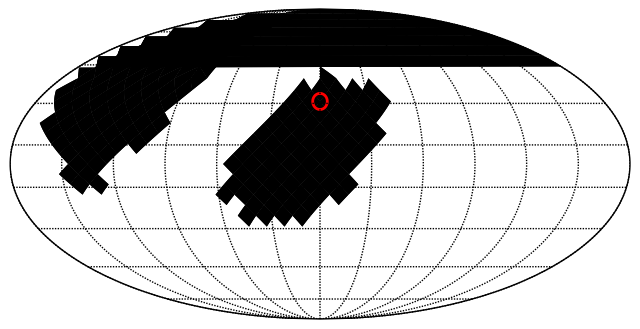

In [352]:
fig

In [341]:
figsaved

AttributeError: 'NoneType' object has no attribute 'print_figure'